# Visualize Traffic Accidents by Hours with HoloView

by [Johnny Chan](https://github.com/Atlas7) | [GitHub Repo](https://github.com/Atlas7/visualize-traffic-accidents-in-uk) | [MIT Licence](https://github.com/Atlas7/visualize-traffic-accidents-in-uk/blob/master/LICENSE)

In [the HoloViews Get-started NYC Taxi example](http://holoviews.org/getting_started/Introduction.html#Effortlessly-exploring-data) I learnt that we could visualize the traffic dropoffs by hour of the day - either interactively with a slide bar, or statically by showing the distribution map snapshot for each hour. Inspired by this example, I've created something similar, but for our traffic accidents dataset. i.e. we can visualize the UK traffic accident distribution on a map-like grid, with an interactive slide bar showing the stats for each hour of the day. See the embedded YouTube video below that I posted - this is what we are going to build in this notebook.

In [1]:
# Embed Youtube video in a Jupyter Notebook.
# https://gist.github.com/christopherlovell/e3e70880c0b0ad666e7b5fe311320a62
from IPython.display import HTML

# Youtube
HTML('<iframe width="750" height=422" src="https://www.youtube.com/embed/vZghnt3FMxY?rel=0" frameborder="0" allow="autoplay; encrypted-media" allowfullscreen></iframe>')

## What is Holoviews

HoloViews is an [open-source](https://github.com/ioam/holoviews/blob/master/LICENSE.txt) Python library designed to make data analysis and visualization seamless and simple. With HoloViews, you can usually express what you want to do in very few lines of code, letting you focus on what you are trying to explore and convey, not on the process of plotting. A major benefit of [HoloView](http://holoviews.org) as described on its website:

> Stop plotting your data - annotate your data and let it visualize itself."

In this notebook we will explore the use of Holoview to perform data exploration analysis on our Traffic Accidents dataset (and restricting our focus only against the 3-year period 2005-2007 for proof of concept purpose).

| ![holoview-benefit.jpg](../assets/images/holoview-benefit.jpg) |
|:-:|
| Image source: [YouTube: HoloViews Let your Data Reveal Itself - SciPy 2016 - Phllip Rudiger and Jean Luc Stevens, et al](https://www.youtube.com/watch?v=0jhUivliNSo)|

## Show me the traffic accident distribution for each hour?

You've got it. This is what we are going to build in this Notebook.

## Setup Notebook

In [2]:
%load_ext autoreload
%autoreload 2


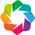

In [3]:
# Standard Scientific libraries
import numpy as np
import pandas as pd

# So we can display bokeh plot inline within our Jupyter Notebook
from bokeh.plotting import output_notebook

# we will need this to build our function later
import math

# we will need this for histogram equalization later
from skimage import exposure

# we will reuse our utility functions to turn Long/Lat values / bounding boxes into Web Mercator values.
from scripts.utils import add_webm_xys, get_plot_params

# Holoview and Bokeh extension! used in the Holoview Example
import holoviews as hv
hv.extension('bokeh')

In [4]:
output_notebook()

Loading BokehJS ...

## Read Data from CSV

As usual, we will require the `Longitude` and `Latitude` columns for plotting data on a geographical space. We will also extract the hour of day from the `Time` Column (we will show you how shortly).

In [5]:
%%time
df = pd.read_csv('../input/accidents_2005_to_2007.csv',
                 usecols=['Longitude','Latitude', 'Time'],
                 dtype={'Longitude': np.float64, 'Latitude': np.float64, 'Time': np.object})

CPU times: user 1.06 s, sys: 58.9 ms, total: 1.12 s
Wall time: 1.12 s


In [6]:
# take a peek of data types
df.dtypes

Longitude    float64
Latitude     float64
Time          object
dtype: object

In [7]:
# take a peek of our DataFrame
df.tail()

,Longitude,Latitude,Time
570006,-3.210294,54.985289,22:01
570007,-3.193693,54.984105,13:12
570008,-2.992068,55.166369,03:07
570009,-3.058338,54.995154,20:00
570010,-3.348857,55.104618,11:31


In [8]:
# How many rows and columns?
df.shape

(570011, 3)

OK. We have around 570k rows (accidents for 2005-2007) and the 3 columns that we extracted from the CSV.

## Drop Rows with Missing Values

To keep things simple, we ought to do a few things up front:

- check if we have any rows with missing values?
- drop the rows with missing values - so we have a clean baseline that is easy to work with.

In [9]:
# Do we have any rows with missing values?
df.isnull().values.any()

True

OK so we have some rows with missing values. How many missing values per column?

In [10]:
# How many missing values per column?
df.isnull().sum()

Longitude    101
Latitude     101
Time          67
dtype: int64

Doesn't seem that many. Let's do one more count, how many rows with at least 1 missing values? (these are what we call "the dirgy rows").

In [11]:
# How many rows with at least 1 missing values?
dirty_rows = len(df[pd.isnull(df).any(axis=1)])
dirty_rows

168

Likewise, how many rows with no missing values at all?

In [12]:
# How many rows with no missing values at all?
clean_rows = len(df[pd.notnull(df).all(axis=1)])
clean_rows

569843

We know that the total number of rows of our DataFrame must equal to the sum of clean and dirty rows. (the following code is just a sanity check. It should produce no errors.)

In [13]:
assert len(df) == dirty_rows + clean_rows

OK let's drop the rows with missing data with the Pandas `DataFrame.dropna`

In [14]:
# We make sure our DataFrame is clean
df = df.dropna(how='any')

Now our DataFrame should contain exclusively clean rows.

In [15]:
# get clean_rows only
len(df)

569843

In [16]:
# our dataframe should not contain any more dirty rows
assert len(df) == clean_rows

## Extract Hour from Time

Let's take a look at what our `Time` column looks like:

In [17]:
# take a peek of our DataFrame
df.head()

,Longitude,Latitude,Time
0,-0.191170,51.489096,17:42
1,-0.211708,51.520075,17:36
2,-0.206458,51.525301,00:15
3,-0.173862,51.482442,10:35
4,-0.156618,51.495752,21:13


It takes the form of `hh:mm` (hour:minute). I'm going to present you with 2 methods that can extract the hour from the time:

- Method 1: Apply an explicit callback function
- Method 2: Apply a throw-away Lambda callback function

Both methods work just fine. Choose the one you like best. I'm going to show you both nevertheless.

### Method 1: apply an explicit callback function

This method is great for keeping things explicit, modular, and reusable. i.e. You create the callback function once, and you just call it whenever you need it. Good for storing it in a library - you just import it and use it. Here, we define our simple callback function, and test it with `assert`.

In [18]:
# Let's define our callback function
def get_hour_from_time(time):
  """given an input object with the form "hh:mm", returns an integer hour portion"""
  hhmm = str(time)  # turn `hh:mm` into a string
  hh = hhmm[:2]     # extract only the `hh` part of the string
  hour = int(hh)    # cast the `hh` into an `int`
  return hour

# let's test out the function (should get no errors)
t1 = df.loc[0, 'Time']  # '17:42'
assert get_hour_from_time(t1) == 17

t2 = df.loc[2, 'Time']  # '00:15'
assert get_hour_from_time(t2) == 0

t3 = df.loc[3, 'Time']  # '10:35'
assert get_hour_from_time(t3) == 10

# clear our temporary test variables
del t1, t2, t3

To apply this function against the `Time` column of our DataFrame we can do something like this.

In [19]:
# let's create a temporary small test dataframe
df2 = df.head().copy()
df2

,Longitude,Latitude,Time
0,-0.191170,51.489096,17:42
1,-0.211708,51.520075,17:36
2,-0.206458,51.525301,00:15
3,-0.173862,51.482442,10:35
4,-0.156618,51.495752,21:13


In [20]:
# Apply our function against this `Time` Column
df2['Time'].apply(get_hour_from_time)

0    17
1    17
2     0
3    10
4    21
Name: Time, dtype: int64

See? Given our `Time` Columns, we get our integer hour. To create a new column `Hour` we simply do this:

In [21]:
# Create a new column `Hour` based on the `Time` column
df2.loc[:, 'Hour'] = df2['Time'].apply(get_hour_from_time)

In [22]:
# Take a peek
df2

,Longitude,Latitude,Time,Hour
0,-0.191170,51.489096,17:42,17
1,-0.211708,51.520075,17:36,17
2,-0.206458,51.525301,00:15,0
3,-0.173862,51.482442,10:35,10
4,-0.156618,51.495752,21:13,21


In [23]:
# take a peek at dtypes
df2.dtypes

Longitude    float64
Latitude     float64
Time          object
Hour           int64
dtype: object

See? This is how you create a new column based on another column in a Pandas DataFrame.

In [24]:
# clear our temporary test dataframe for tidiness
del df2

### Method 2: Apply a throw-away Lambda callback function

If you are the sort of person who like short and simple code, this method is just for you. Instead of writing an explicit function, we define a temporary throw-away function, and apply it straight away. Like this:

In [25]:
# let's create a temporary small test dataframe
df2 = df.head().copy()
df2

,Longitude,Latitude,Time
0,-0.191170,51.489096,17:42
1,-0.211708,51.520075,17:36
2,-0.206458,51.525301,00:15
3,-0.173862,51.482442,10:35
4,-0.156618,51.495752,21:13


In [26]:
# Apply a throw-away Lambda function that extracts integer hour from hh:mm Time
df2['Time'].apply(lambda x: int(str(x)[:2]))

0    17
1    17
2     0
3    10
4    21
Name: Time, dtype: int64

See? Same output as Method 1. To create a new column is similar:

In [27]:
df2.loc[:, 'Hour'] = df2['Time'].apply(lambda x: int(str(x)[:2]))
df2.head()

,Longitude,Latitude,Time,Hour
0,-0.191170,51.489096,17:42,17
1,-0.211708,51.520075,17:36,17
2,-0.206458,51.525301,00:15,0
3,-0.173862,51.482442,10:35,10
4,-0.156618,51.495752,21:13,21


In [28]:
# take a peek at dtypes
df.dtypes

Longitude    float64
Latitude     float64
Time          object
dtype: object

See? This is how you create a new column based on another column in a Pandas DataFrame, with Lambdas call-back function.

In [29]:
# clear our temporary test dataframe for tidiness
del df2

## Let's create the Hour column for real

Now we've learnt how to create a new column with Method 1 (apply an explicit callback function) and Method 2 (apply a throw-away callback function), let's just pick one and apply it for our actual DataFrame! Since earlier we've mention the benefit of Method 1 is reusability, let's make it so! Let's reuse it. We will use Method 1 here.

In [30]:
df.loc[:, 'Hour'] = df['Time'].apply(get_hour_from_time)
df.head()

,Longitude,Latitude,Time,Hour
0,-0.191170,51.489096,17:42,17
1,-0.211708,51.520075,17:36,17
2,-0.206458,51.525301,00:15,0
3,-0.173862,51.482442,10:35,10
4,-0.156618,51.495752,21:13,21


In [31]:
# take a peek at dtypes
df.dtypes

Longitude    float64
Latitude     float64
Time          object
Hour           int64
dtype: object

In [32]:
# how many rows and columns?
df.shape

(569843, 4)

Done. We have our `Hour` column. Easy.

## Add Web Mercator Coordinates

Like in our [previous notebook](./Visualize-Traffic-Accidents-in-UK-with-Datashader.ipynb), given our Longitude and Latitude values, we create two columns `webm_x` and `webm_y` that corresponds to the X and Y Web Mercator coordinate values.

In [33]:
df = add_webm_xys(df)

In [34]:
# take a peek
df.head()

,Longitude,Latitude,Time,Hour,webm_x,webm_y
0,-0.191170,51.489096,17:42,17,-21280.947055,6.708269e+06
1,-0.211708,51.520075,17:36,17,-23567.226757,6.713810e+06
2,-0.206458,51.525301,00:15,0,-22982.799430,6.714745e+06
3,-0.173862,51.482442,10:35,10,-19354.229308,6.707080e+06
4,-0.156618,51.495752,21:13,21,-17434.636009,6.709459e+06


Done! Our DataFrame looks beautiful.

## Define bounding boxes

Like in our [previous notebook](./Visualize-Traffic-Accidents-in-UK-with-Datashader.ipynb), we can define our bounding boxes in Longitude and Latitude Ranges, for experimentation purposes.

In [35]:
# We will only use on of these in this notebook. The rest are just for just in case purpose.
bboxes = {
  "gb": ((-15.381, 7.251), (48.749, 61.502)),
  "gb_mainland": ( (-12.129, 5.120), (49.710, 58.745)),
  "gb_long": ((-8.745, 2.241), (48.749, 61.502)),
  "gb_wide": ((-21.709, 15.293), (48.749, 61.502)),
  "london": ((-0.643, 0.434), (51.200, 51.761)),
  "london_2": ((-0.1696, 0.0130), (51.4546, 51.5519)),
  "london_3": ((-0.1330, -0.0235), (51.4741, 51.5322)),  
  "manchester": ((-3.049, -1.505), (52.975, 53.865))
}

Given a bounding box, we can obtain the Web Mercator `x_range` and `y_range`, and the plot `plot_width` and `plot_height` easily, with our own utility function. These 4 variables as you shall see, will be used in pretty much in many of our notebooks.

In [36]:
bbox = bboxes["gb_mainland"]

In [37]:
# Get the usual plot parameters
x_range, y_range, plot_width, plot_height = get_plot_params(bbox)

In [38]:
# Long/Lat (in degrees)
print("longitude_range: {}".format(bbox[0]))
print("latitude_range: {}".format(bbox[1]))
# Web Mercator (in meters)
print("x_range: {}".format(x_range))
print("y_range: {}".format(x_range))
# Our plot (in pixels)
print("plot_width: {}".format(plot_width))
print("plot_height: {}".format(plot_height))

longitude_range: (-12.129, 5.12)
latitude_range: (49.71, 58.745)
x_range: [-1350194.10383162   569955.79286156]
y_range: [-1350194.10383162   569955.79286156]
plot_width: 750
plot_height: 675


## Assign X-Y grid index for each data point

If we look at the [the HoloViews Get-started NYC Taxi example](http://holoviews.org/getting_started/Introduction.html#Effortlessly-exploring-data) carefully, we'd see that the core data structure required for generating our final output is effectively a Python `dict`, where the keys are the hours, and the values are 2D arrays of aggregated values in the X and Y directions for the plot. The `dict` data structure looks something like this:

```.py
dictionary = {
  0: np.array([
    [x, x, x],
    [x, x, x],
    [x, x, x],
    [x, x, x]
  ]),
  1: np.array([
    [x, x, x],
    [x, x, x],
    [x, x, x],
    [x, x, x]
  ]),
  ...
  22: np.array([
    [x, x, x],
    [x, x, x],
    [x, x, x],
    [x, x, x]
  ]),    
  23: np.array([
    [x, x, x],
    [x, x, x],
    [x, x, x],
    [x, x, x]
  ])  
}
```

Think of the 2D array as what you would actually see on a map. The bottom left corner of the 2D array corresponds to the aggregated value of the grid at `min_x` and `min_y`. The top-right corner of the 2D array corresponds to the aggregated value of the grid at `max_x` and `max_y`.

By feeding this `dict` to the following one line code, we will have our visualization with an interactive sliding bar for the changing hour of the day:

```.py
hv.HoloMap(dictionary, kdims='Hour')
```

In this section we will implement an algorithm to transform our Pandas DataFrame into the `dict` data structure as required. The diagrams that I include below shows only the transformation in the X direction - it is essentially the same in the Y direction (which we shall see in codes later on).

**Note to self**: the algorithm below may not have been the most elegant or "Pythonic" way. At the time of doing the transformation, I might have used some old habits carried over from my commercial SAS/SQL experience. I would be keen to find a more Pythonic way to do this step later on though!

### Step 1: Apply Bounding Box

We've already computed our Web Mercator ranges (`x_range` and `y_range`). This diagram shows what the Web Mercator Space in the X-direction looks like (it will be similar in the Y direction).

![x_to_grid_1.png](../assets/images/x_to_grid_1.png)

### Step 2: Define Grid Resolution

Now we need to ask ourself the question: how fine do we want our plot to look? The more the grids we have, the higher our plot resolution (and more memory required to stored the grid matrix). We define `N_x` as the number of grids we would like in the X-direction. We can then compute the grid size (in meters) with the formula included in the diagram (note: this is just a mini formula that I put together - it seems to work quite well). (Note: similar computation in the Y-direction)

![x_to_grid_2.png](../assets/images/x_to_grid_2.png)

In [39]:
# define grid resolution in the X and Y directions.
#   - Recommend a minimum of 64.
#   - no larger than 512 unless you have lots of RAM.
#   - use sys.getsizeof(var) to determine the size of a variable in bytes. 
N_x = 200
N_y = 200

### Step 3: Assign Data Points to Grids

We have grid number (`N_x`), size of grid (`S_x`), the minimum X-value `min_x`, and the Web Mercator X-value of each data point (`webm_x` in our DataFrame). We can plug these values into a formula and obtain a grid index in the X-direction. I've also included a formula to translate the grid index back to a Web Mercator coordinate for information - though it turns out it will not be needed in the plot. (Note: similar computation in the Y-direction)

![x_to_grid_3.png](../assets/images/x_to_grid_3.png)

In [40]:
# transfrom from a Web Mercator value to a grid index
def x2grid(x, min_x, max_x, n=N_x):
  s = (max_x - min_x) / n
  index_x = math.floor((x-min_x)/s)
  webm_index_x = min_x + index_x*s
  return index_x, webm_index_x

# test out the function. Should get same value as what we expected from the diagram above
assert x2grid(-5, -5, 5, n=5) == (0, -5.)
assert x2grid(-4, -5, 5, n=5) == (0, -5.)
assert x2grid(-3, -5, 5, n=5) == (1, -3.)
assert x2grid(-2, -5, 5, n=5) == (1, -3.)
assert x2grid(-1, -5, 5, n=5) == (2, -1.)
assert x2grid(-0, -5, 5, n=5) == (2, -1.)
assert x2grid(1, -5, 5, n=5) == (3, 1.)
assert x2grid(2, -5, 5, n=5) == (3, 1.)
assert x2grid(3, -5, 5, n=5) == (4, 3.)
assert x2grid(4, -5, 5, n=5) == (4, 3.)
assert x2grid(5, -5, 5, n=5) == (5, 5.)

# for i in range(-5, 5, 1):
#   grid = x2grid(i, -5, 5, n=5)
#   print(grid)

In [41]:
# Create a wrapper to call our x2grid transformation function in both X and Y direction.
def xy2grid(x, y, min_x, max_x, min_y, max_y, n_x=N_x, n_y=N_y):
  index_x, webm_index_x = x2grid(x, min_x, max_x, n=n_x)
  index_y, webm_index_y = x2grid(y, min_y, max_y, n=n_y)
  return index_x, index_y, webm_index_x, webm_index_y

# quick tests
assert xy2grid(-5, -5, -5, 5, -5, 5, n_x=5, n_y=5) == (0, 0, -5, -5.)
assert xy2grid(-4, -5, -5, 5, -5, 5, n_x=5, n_y=5) == (0, 0, -5, -5.)
assert xy2grid(-3, -5, -5, 5, -5, 5, n_x=5, n_y=5) == (1, 0, -3, -5.)

In [42]:
# df[['webm_x']].head()

In [43]:
# df[['webm_x', 'webm_y']].head()

In [44]:
# df[['webm_x']].head().apply(lambda row: x2grid(row['webm_x'], x_range[0], x_range[1], n=N_x), axis=1).head()

In [45]:
# give it a test. Given our dataframe, compute grid index in X and Y directions, and web mercator values of these indices
df[['webm_x', 'webm_y']].head().apply(lambda row: xy2grid(row['webm_x'], row['webm_y'], x_range[0], x_range[1], y_range[0], y_range[1], n_x=N_x, n_y=N_y), axis=1)

0    (138, 36, -25290.6751133, 6707472.37125)
1    (138, 36, -25290.6751133, 6707472.37125)
2    (138, 36, -25290.6751133, 6707472.37125)
3    (138, 35, -25290.6751133, 6698826.01657)
4    (138, 36, -25290.6751133, 6707472.37125)
dtype: object

In [46]:
# Let's do it for real. Create these extra columns (may take around 10 seconds)
df.loc[:, 'grid_index_x'],\
df.loc[:, 'grid_index_y'],\
df.loc[:, 'webm_index_x'],\
df.loc[:, 'webm_index_y']\
= zip(*df[['webm_x', 'webm_y']].apply(\
                                      lambda row: \
                                      xy2grid(\
                                              row['webm_x'], row['webm_y'],\
                                              x_range[0], x_range[1],\
                                              y_range[0], y_range[1],\
                                              n_x=N_x, n_y=N_y), axis=1))

In [47]:
# take a quick peek! (set a random_state seed for controled randomness)
df.sample(10, random_state=1)

,Longitude,Latitude,Time,Hour,webm_x,webm_y,grid_index_x,grid_index_y,webm_index_x,webm_index_y
321336,-0.714548,51.874649,05:35,5,-79543.119507,6.777492e+06,132,44,-82895.172014,6.776643e+06
450945,-1.321516,53.418183,14:40,14,-147110.488195,7.060728e+06,125,76,-150100.418398,7.053327e+06
50538,-2.596329,53.369182,11:55,11,-289022.022212,7.051581e+06,110,75,-294111.660650,7.044680e+06
381662,-3.782953,56.040163,09:15,9,-421116.401655,7.566415e+06,96,135,-428522.153419,7.563461e+06
467636,-2.012977,52.657637,17:20,17,-224083.574619,6.919919e+06,117,60,-226906.414266,6.914985e+06
523747,0.355308,51.434963,10:00,10,39552.705635,6.698597e+06,144,34,32313.821787,6.690180e+06
27679,-2.989028,54.251944,06:09,6,-332737.074927,7.218017e+06,105,95,-342115.408068,7.217607e+06
269506,-0.284070,53.748130,18:25,18,-31622.527750,7.122599e+06,137,84,-34891.424597,7.122497e+06
11087,-0.087950,51.491055,11:59,11,-9790.549215,6.708620e+06,139,36,-15689.925630,6.707472e+06
462656,-1.998492,52.553444,08:50,8,-222471.111794,6.900821e+06,117,58,-226906.414266,6.897692e+06


We have successfully created the transformed grid indices in the X and Y directions. These will be useful in forming the `dict` required for the eventual output later on.

## Aggregation in Pandas

In order to get to our eveutal `dict` data structure for the plot, we need to be able to aggregate our DataFrame by `Hour`, `grid_index_x`, and `grid_index_y`. let's try some experiments (without storing the outputs yet).

In [48]:
# count all accidents by hour
df.groupby(['Hour']).size()

Hour
0      9513
1      6919
2      5830
3      4172
4      3068
5      4259
6      9041
7     22631
8     40744
9     27696
10    25202
11    28901
12    33674
13    34584
14    34151
15    43424
16    45745
17    50052
18    38879
19    30002
20    22737
21    18511
22    16440
23    13668
dtype: int64

In [49]:
# count all accidents by hour for each grid
df.groupby(['Hour', 'grid_index_x', 'grid_index_y']).size()

Hour  grid_index_x  grid_index_y
0     61            179              1
      62            181              1
      64            168              1
      66            186              1
      69            148              1
      72            155              1
                    163              2
                    168              1
      74            164              1
                    177              1
      75            7                1
      76            7                1
                    8                3
                    9                2
                    10               1
      77            8                3
                    9                2
                    125              1
                    134              1
                    140              1
                    178              1
      78            9                3
      79            7                4
                    8                1
                    9          

In [50]:
# how to output aggregated output as a fresh new DataFrame?
# https://stackoverflow.com/questions/10373660/converting-a-pandas-groupby-object-to-dataframe
df.groupby(['Hour', 'grid_index_x', 'grid_index_y']).size().reset_index().head()

,Hour,grid_index_x,grid_index_y,0
0,0,61,179,1
1,0,62,181,1
2,0,64,168,1
3,0,66,186,1
4,0,69,148,1


## Pandas SQL Left Join

I will be using SQL Left join to enable me to perform the transformation that I need to get closer to the `dict` data structure we need. See comments for more info.

In [51]:
# how to rename that "ugly" column name "0" into "accidents"?
# output result to a dataframe `rkv` (right key value). For our SQL left join later.
# https://stackoverflow.com/questions/10373660/converting-a-pandas-groupby-object-to-dataframe
rkv = pd.DataFrame({'accidents' : df.groupby( [ "Hour", "grid_index_x", 'grid_index_y'] ).size()}).reset_index()
rkv.head()

,Hour,grid_index_x,grid_index_y,accidents
0,0,61,179,1
1,0,62,181,1
2,0,64,168,1
3,0,66,186,1
4,0,69,148,1


In [52]:
# Create our `lkv` (left key value) table for our SQL left join.
# Let's build a cartesian product table containing all possible combinations of hour and grids.
# https://stackoverflow.com/questions/13269890/cartesian-product-in-pandas#comment-72592602
a = pd.DataFrame(data={'Hour': np.arange(24)})
b = pd.DataFrame(data={'grid_index_x': np.arange(N_x)})
c = pd.DataFrame(data={'grid_index_y': np.arange(N_y)})
ab = pd.merge(a.assign(key=0), b.assign(key=0), on='key').drop('key', axis=1)
lkv = pd.merge(ab.assign(key=0), c.assign(key=0), on='key').drop('key', axis=1)
lkv.head()

,Hour,grid_index_x,grid_index_y
0,0,0,0
1,0,0,1
2,0,0,2
3,0,0,3
4,0,0,4


In [53]:
# Do the left join. Replace missing values with 0.
# https://stackoverflow.com/questions/33086881/merge-two-python-pandas-data-frames-of-different-length-but-keep-all-rows-in-out/33086953
# http://pandas.pydata.org/pandas-docs/version/0.17.0/generated/pandas.DataFrame.fillna.html
grid1 = lkv.merge(rkv,
          how='left',
          left_on=["Hour", "grid_index_x", 'grid_index_y'],
          right_on=["Hour", "grid_index_x", 'grid_index_y']).fillna(0)

In [54]:
# free up some memory (now that we are done with the SQL left join)
del a, b, c, ab, lkv, rkv

## Visualization 1 (Linear)

Here we will tranform our data into the desirable `dict` data structure format, plug into the Holoview example sample code, and visualize. I will describe my codes as comments.

In [55]:
# take a peek
grid1.head(10)

,Hour,grid_index_x,grid_index_y,accidents
0,0,0,0,0.0
1,0,0,1,0.0
2,0,0,2,0.0
3,0,0,3,0.0
4,0,0,4,0.0
5,0,0,5,0.0
6,0,0,6,0.0
7,0,0,7,0.0
8,0,0,8,0.0
9,0,0,9,0.0


In [56]:
# output DataFrame as a numpy 2D array (i.e. a Matrix)
grid2 = grid1.as_matrix(["Hour", "grid_index_x", 'grid_index_y', 'accidents']).copy()
grid2

array([[   0.,    0.,    0.,    0.],
       [   0.,    0.,    1.,    0.],
       [   0.,    0.,    2.,    0.],
       ..., 
       [  23.,  199.,  197.,    0.],
       [  23.,  199.,  198.,    0.],
       [  23.,  199.,  199.,    0.]])

In [57]:
# Initialize our dict data structure
dict1 = {}
for i in range(24):
  dict1[i] = np.zeros((N_y, N_x))

In [58]:
# take a peek at hour 17 values
dict1[17]

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

In [59]:
# Note: our min_y index is stored in the last row, and the max_y index is stored in first row
# for ease of indexing later on we will need to "flip" the array up-side down later on
# this example shows us how (with the [::-1] indexing style)
j = np.array([
  [1, 2],
  [3, 4],
  [5, 6]
])

# flip array up-side down
j[::-1]

array([[5, 6],
       [3, 4],
       [1, 2]])

In [60]:
# e.g. take a peek at hour 1, grid 5 in Y direction and grid 10 in X direction. 
dict1[1][::1][5][10]

0.0

In [61]:
# e.g. take a peek at hour 17, grid 10 in Y direction and grid 20 in X direction.
dict1[17][::1][10][20]

0.0

In [62]:
# Now, populate each grid with accident counts
for row in grid2:
  hour, grid_index_x, grid_index_y, accidents = row
  hour=int(hour)
  grid_index_x = int(grid_index_x)
  grid_index_y = int(grid_index_y)
#   print(hour, grid_index_x, grid_index_y, accidents)
  dict1[hour][::-1][grid_index_y][grid_index_x] = accidents

In [63]:
# The `bounds` is required by the Holoview example
# bounds = (left, bottom, right, top)
bounds = (x_range[0], y_range[0], x_range[1], y_range[1])

In [64]:
# just clone the Holoview example!
dict1b = {int(hour):hv.Image(arr, ['x','y'], bounds=bounds) 
              for hour, arr in dict1.items()}

In [65]:
holomap1 = hv.HoloMap(dict1b, kdims='Hour')
print(holomap1)

:HoloMap   [Hour]
   :Image   [x,y]   (z)


In [66]:
%%opts Image  [height=350 width=350 xaxis=None yaxis=None]

holomap1

:HoloMap   [Hour]
   :Image   [x,y]   (z)

In [67]:
# %%opts Image  [height=200 width=200 xaxis=None yaxis=None]

# Uncomment below to show hour 3, 6, 9, 12
# holomap1.select(Hour={3,6,9,12}).layout()

In [68]:
%%opts Image  [height=200 width=200 xaxis=None yaxis=None]

holomap1.select().layout()

:NdLayout   [Hour]
   :Image   [x,y]   (z)

Note that we we scroll along the Hour value we can roughly visualize the hot spots with higher traffic accidents (e.g. London and North East of England. We can sort of make out the shape of UK. But the color is a bit dim (due to skew distribution - some regions have significant higher traffic accident counts than other).

To even out the distribution a bit so the map is plot a bit clearer, we need to use Histogram Equalization, as we introduced in our introductory article. Fortunately, I've found a neat solution from Stackoverflow - to apply Histogram Equalization on a Numpy 2D array directory. (with the use of Scikit-Image and a function).

## Visualization 2 (Histogram Equalization)

In [69]:
# Histogram Equalization
# https://stackoverflow.com/questions/28518684/histogram-equalization-of-grayscale-images-with-numpy
from skimage import exposure
import numpy as np
def histogram_equalize(img):
#     img = rgb2gray(img)
    img_cdf, bin_centers = exposure.cumulative_distribution(img)
    return np.interp(img, bin_centers, img_cdf)

In [70]:
# let's try it out on hour 17 of our `dict1` (note all the "0" now have some values)
histogram_equalize(dict1[17])

array([[ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775],
       [ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775],
       [ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775],
       ..., 
       [ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775],
       [ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775],
       [ 0.932775,  0.932775,  0.932775, ...,  0.932775,  0.932775,
         0.932775]])

In [71]:
# Let's concatenate the 2D arrays of all 24 hours, and apply histogram equalization for all the grids.
# Note to self: this step could have been done more elegantly with functional programming.
#               another job for another day. This works for now - so hey ho!
base = dict1[0].copy()
for i in range(1, 24):
  base = np.concatenate((base, dict1[i]), axis=0)

In [72]:
base.shape
# N_x grids in X-directions. i.e. N_x columns.
# N_y grids in Y-directions. And stacked over 24 hour chunks. i.e. N_y*24 rows

(4800, 200)

In [73]:
# apply histogram equalization for this giant 2D array!
base_heq = histogram_equalize(base)
base_heq.shape

(4800, 200)

In [74]:
# now, split back out into 24 chunks for the 24 hours
base_heq_24 = np.split(base_heq, 24)
len(base_heq_24)

24

In [75]:
# rebuild our dictionary. Our values are now "histogram equalized"
dict2 = {}
for i in range(24):
  dict2[i] = base_heq_24[i]

In [76]:
# take a peek at hour 17
dict2[17]

array([[ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625],
       [ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625],
       [ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625],
       ..., 
       [ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625],
       [ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625],
       [ 0.9591625,  0.9591625,  0.9591625, ...,  0.9591625,  0.9591625,
         0.9591625]])

In [77]:
# just clone the holoview example!
dict2b = {int(hour):hv.Image(arr, ['x','y'], bounds=bounds) 
              for hour, arr in dict2.items()}

In [78]:
holomap2 = hv.HoloMap(dict2b, kdims='Hour')
print(holomap2)

:HoloMap   [Hour]
   :Image   [x,y]   (z)


In [79]:
%%opts Image  [height=350 width=350 xaxis=None yaxis=None tools=['hover']]

holomap2

:HoloMap   [Hour]
   :Image   [x,y]   (z)

Note that our plot now looks more vivid! (region with low traffic accident counts are now also shown on the map. This plot shows better structure).

In [80]:
# %%opts Image  [height=200 width=200 xaxis=None yaxis=None]

# Uncomment below to show hour 3, 6, 9, 12
# holomap2.select(Hour={3,6,9,12}).layout()

In [81]:
%%opts Image  [height=200 width=200 xaxis=None yaxis=None]

holomap2.select().layout()

:NdLayout   [Hour]
   :Image   [x,y]   (z)

## Conclusion

In this notebook we have implemented the HoloViews NYC Taxi visualization by hour code against our UK Traffic Accident dataset. We have performed data transformation to arrive the required Python `dict` data structure as required by HoloViews, including the use of Pandas `groupby` and SQL Left Join. We created both interactive and static charts showing UK Traffic accident distribution by hour. We implemented two visualizations namely "Linear" (show magnitude) and "Histogram Equalization" (show structure) styles. This notebook may be used as a baseline for further code optimizations, to make it more "Pythonic", elegant, and efficient.

## What Next

Note the size of this notebook is quite large, due to the pretty modest grid resolution (256 grids in each direction), and the number of plots. If too high resolution, the file size might end up too large (and require more memory to run notebook - which may crash our laptop). Try play around with different resolutions and get the one that work best.

One thing I would like to see is a similar demo, but with Datashader integration to show dynamic zoom/pan aggregation, to increase interaction further. Another job for another day.